<a href="https://colab.research.google.com/github/yuukionna022/ComputerVisionFontsExtended/blob/main/FinalPipeline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Run All Blocks Before Using

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
import cv2
import seaborn as sns
import glob
import xml.etree.ElementTree as ET
from PIL import Image
import os
import shutil

In [3]:
%pip install ultralytics
import ultralytics
ultralytics.checks()
from ultralytics import YOLO

Ultralytics 8.3.49 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 32.6/107.7 GB disk)


In [4]:
def get_outer(obb_data, w, h):
  x_min, y_min = w, h
  x_max, y_max = 0, 0

  for point in obb_data:
    x, y = point
    x_min = min(x_min, x)
    y_min = min(y_min, y)
    x_max = max(x_max, x)
    y_max = max(y_max, y)

  return int(x_min), int(y_min), int(x_max), int(y_max)

def overlapping(box1, box2):
  x1_min, y1_min = box1[0]
  x1_max, y1_max = box1[1]

  x2_min, y2_min = box2[0]
  x2_max, y2_max = box2[1]

  if(x1_min < x2_max and x1_max > x2_min) and (y1_min < y2_max and y1_max > y2_min):
    return True

  return False

def merge(boxes):
  merged_boxes = []

  while boxes:
    # remove first box from the list and process it
    box1 = boxes.pop(0)
    merged = False

    for i, box2 in enumerate(boxes):
      if(overlapping(box1, box2)):
        x1_min, y1_min = box1[0]
        x1_max, y1_max = box1[1]

        x2_min, y2_min = box2[0]
        x2_max, y2_max = box2[1]

        # new box
        box = [
            (min(x1_min, x2_min), min(y1_min, y2_min)),
            (max(x1_max, x2_max), min(y1_max, y2_max)),
        ]

        boxes[i] = box
        merged = True
        break
    if not merged:
      merged_boxes.append(box1)

  return merged_boxes

def crop_img(img, boxes, w, h):
  cropped_imgs = []

  for box in boxes:
    (x_min, y_min), (x_max, y_max) = box

    threshold = 8
    x_min -= threshold
    y_min -= threshold
    x_max += threshold
    y_max += threshold

    x_min = max(0, x_min)
    y_min = max(0, y_min)
    x_max = min(w, x_max)
    y_max = min(h, y_max)

    cropped_img = img[int(y_min):int(y_max), int(x_min):int(x_max)]
    cropped_imgs.append(cropped_img)

  return cropped_imgs

def scale(file_paths, output_folder, size):
  scaled_image_paths = []

  for file_dir in file_paths:
    file_name = os.path.basename(file_dir)
    output_path = os.path.join(output_folder, file_name)

    with Image.open(file_dir) as img:
      img_resized = img.resize(size)
      img_resized.save(output_path)
      scaled_image_paths.append(output_path)

  return scaled_image_paths

def identify_font(img_path, scale_img):
  #combined piece of code to get cropped images and list of their paths
  #get the predicted boxes
  results = det_model(img_path)
  #get the coordinates of the bounding boxes
  obss = results[0].obb.xyxyxyxy.tolist()
  #load the original image
  image_path = results[0].path
  image = cv2.imread(image_path)
  #get the width and height of the image
  width = image.shape[1]
  height = image.shape[0]
  #get the image name
  name = os.path.splitext(os.path.basename(img_path))[0]
  #create a list of the all the bounding box coordinates
  coords = []
  #go through the bounding boxes and find the top left, and bottom right coordinate
  for i, bbox in enumerate(obss):
    x_min, y_min, x_max, y_max = get_outer(bbox, width, height)
    coords.append([(x_min, y_min), (x_max, y_max)])
  #merge bounding boxes that overlap
  merged = merge(coords)
  #get the coordinates to crop the image
  cropped = crop_img(image, merged, width, height)
  #list to keep file paths to feed into next model
  all_img_paths = []
  #creating the files
  for i, cropped_img in enumerate(cropped):
    os.makedirs('/content/Cropped Images/', exist_ok=True)
    cv2.imwrite('/content/Cropped Images/' + name + f'_{i}.jpg', cropped_img)
    all_img_paths.append('/content/Cropped Images/' + name + f'_{i}.jpg')
    print("Created cropped file: " + '/content/Cropped Images/' + name + f'_{i}.jpg')

  if scale_img:
    output_dir = "/content/Resized Images"
    os.makedirs(output_dir, exist_ok=True)
    size = (640,640)
    scaled_images_paths = scale(all_img_paths, output_dir, size)

    for font_img in scaled_images_paths:
      clsmodel.predict(font_img, imgsz= (256, 640), save = True)
  else:
    for font_img in all_img_paths:
      clsmodel.predict(font_img, imgsz= (256, 640))

In [5]:
#download "thefinalmodel.pt" and replace the file path
det_model = YOLO("/content/drive/MyDrive/Final Project Transferred/thefinalmodel.pt")

In [6]:
#download "classmodel.pt" and replace the file path
clsmodel = YOLO("/content/drive/MyDrive/Final Project Transferred/classmodel.pt")

# Final use testing

In [7]:
#input file path, set true if want to scale before predicting, false otherwise (false works better)
identify_font("/content/drive/MyDrive/IAT 360/Computer Vision Project/test/BrushScriptMT/BrushscriptMT$$test_1.png", False)


image 1/1 /content/drive/MyDrive/IAT 360/Computer Vision Project/test/BrushScriptMT/BrushscriptMT$$test_1.png: 640x480 622.0ms
Speed: 16.4ms preprocess, 622.0ms inference, 48.5ms postprocess per image at shape (1, 3, 640, 480)
Created cropped file: /content/Cropped Images/BrushscriptMT$$test_1_0.jpg
Created cropped file: /content/Cropped Images/BrushscriptMT$$test_1_1.jpg
Created cropped file: /content/Cropped Images/BrushscriptMT$$test_1_2.jpg
Created cropped file: /content/Cropped Images/BrushscriptMT$$test_1_3.jpg

image 1/1 /content/Cropped Images/BrushscriptMT$$test_1_0.jpg: 640x640 Calligraphy 0.96, Calvin 0.02, Comic Sans MS 0.02, Hombre 0.00, Monotype Corsiva 0.00, 312.0ms
Speed: 61.9ms preprocess, 312.0ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Cropped Images/BrushscriptMT$$test_1_1.jpg: 640x640 Calligraphy 0.93, Comic Sans MS 0.03, Monotype Corsiva 0.03, Hombre 0.01, Calvin 0.01, 350.0ms
Speed: 43.2ms preprocess, 350.0ms inference

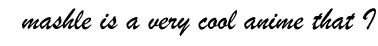

In [8]:
Image.open("/content/Cropped Images/BrushscriptMT$$test_1_0.jpg")

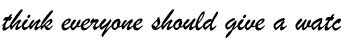

In [9]:
Image.open("/content/Cropped Images/BrushscriptMT$$test_1_1.jpg")

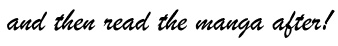

In [10]:
Image.open("/content/Cropped Images/BrushscriptMT$$test_1_2.jpg")

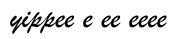

In [11]:
Image.open("/content/Cropped Images/BrushscriptMT$$test_1_3.jpg")

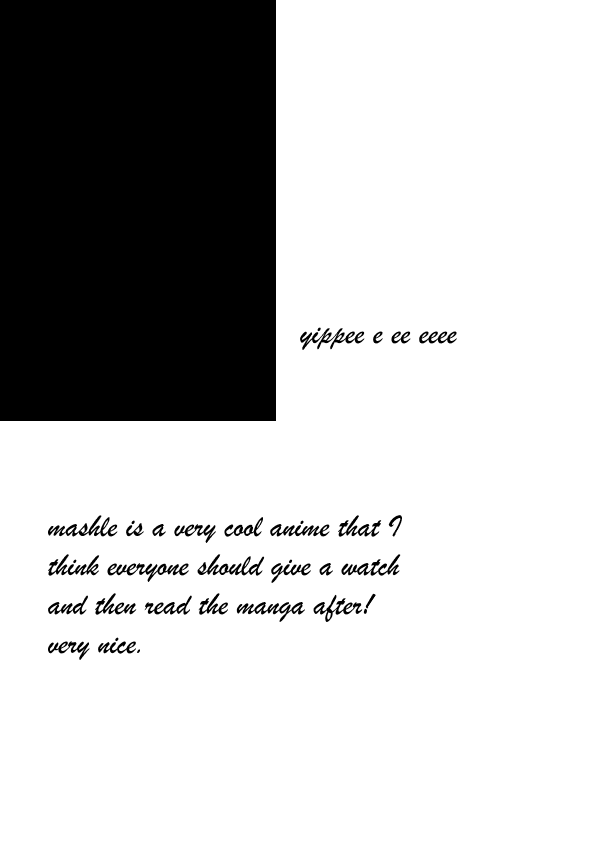

In [12]:
Image.open("/content/drive/MyDrive/IAT 360/Computer Vision Project/test/BrushScriptMT/BrushscriptMT$$test_1.png")

In [13]:
#www.reddit.com/r/FaithNoMore/comments/1exsaum/forgot_i_had_these_posters_only_1_was_ever_hung/#lightbox images from here
identify_font("/content/drive/MyDrive/Final Project Transferred/Testing Images/redditimg1.png", False)


image 1/1 /content/drive/MyDrive/Final Project Transferred/Testing Images/redditimg1.png: 640x480 668.1ms
Speed: 5.1ms preprocess, 668.1ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 480)
Created cropped file: /content/Cropped Images/redditimg1_0.jpg

image 1/1 /content/Cropped Images/redditimg1_0.jpg: 640x640 Helvetica 0.84, Futura 0.16, Didot 0.00, Steppes TT 0.00, Calibry 0.00, 440.1ms
Speed: 47.2ms preprocess, 440.1ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)


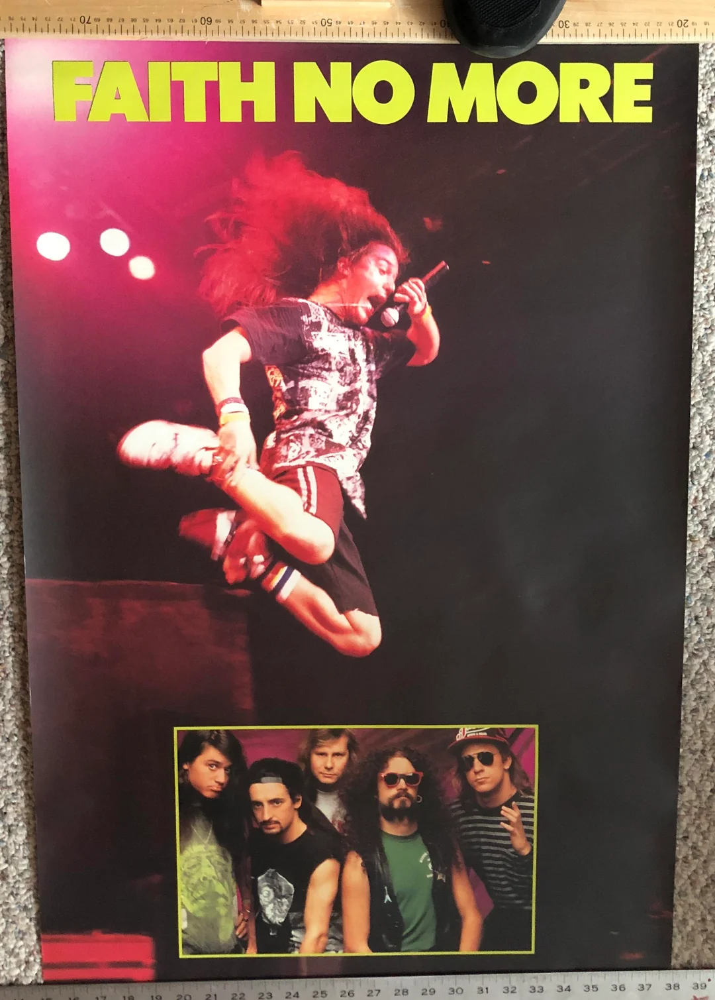

In [14]:
Image.open("/content/drive/MyDrive/Final Project Transferred/Testing Images/redditimg1.png")

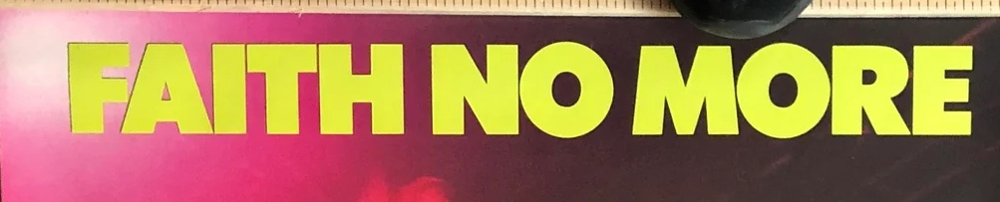

In [15]:
Image.open("/content/Cropped Images/redditimg1_0.jpg")

In [19]:
identify_font("/content/drive/MyDrive/Final Project Transferred/Testing Images/redditimg3.png", False)


image 1/1 /content/drive/MyDrive/Final Project Transferred/Testing Images/redditimg3.png: 640x480 630.0ms
Speed: 5.1ms preprocess, 630.0ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 480)
Created cropped file: /content/Cropped Images/redditimg3_0.jpg
Created cropped file: /content/Cropped Images/redditimg3_1.jpg

image 1/1 /content/Cropped Images/redditimg3_0.jpg: 640x640 Helvetica 0.98, Futura 0.02, Didot 0.00, Steppes TT 0.00, Nasalization 0.00, 429.4ms
Speed: 55.9ms preprocess, 429.4ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Cropped Images/redditimg3_1.jpg: 640x640 Helvetica 0.55, Futura 0.37, Didot 0.08, Steppes TT 0.00, Myriad 0.00, 420.8ms
Speed: 56.5ms preprocess, 420.8ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)


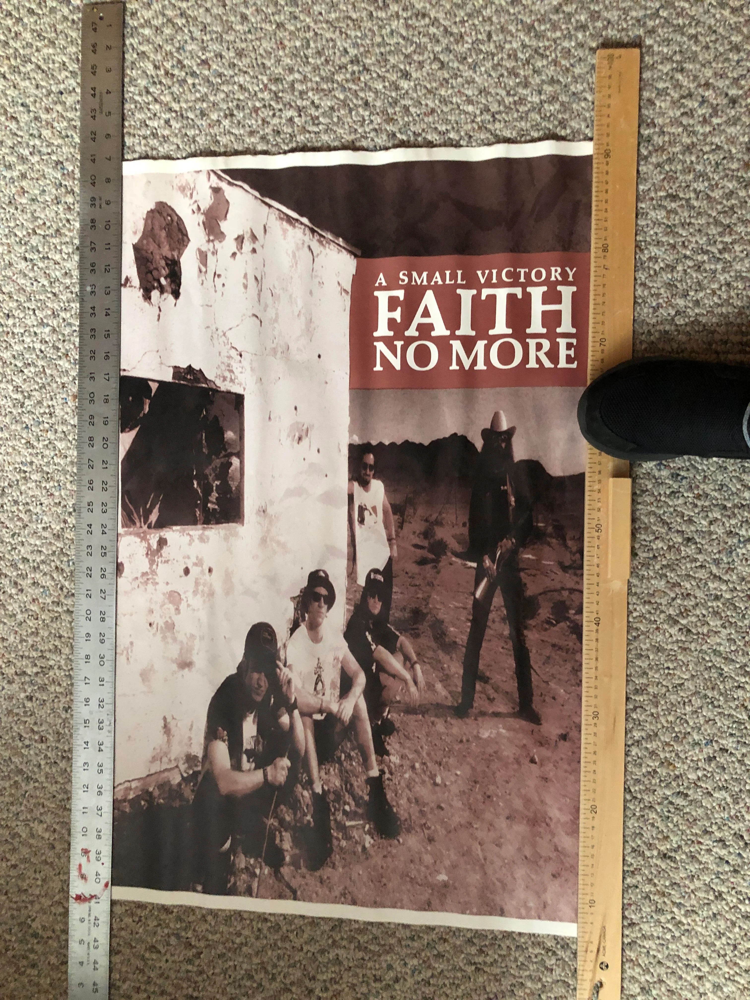

In [20]:
Image.open("/content/drive/MyDrive/Final Project Transferred/Testing Images/redditimg3.png")

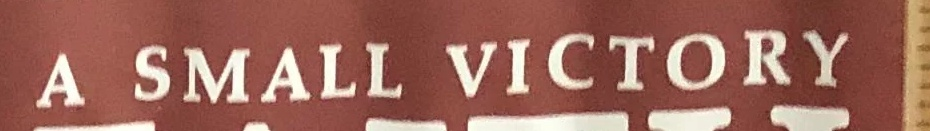

In [21]:
Image.open("/content/Cropped Images/redditimg3_0.jpg")

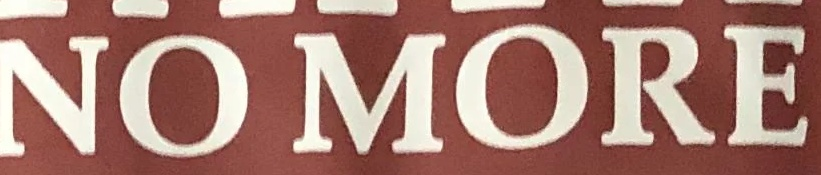

In [22]:
Image.open("/content/Cropped Images/redditimg3_1.jpg")